In [1]:
import requests
import json
import jsondiff
import numpy as np
import matplotlib.pyplot as plt
import smopy
from numpy.random import default_rng
import scipy.spatial.distance
import scipy.stats
import datetime
from IPython import display
import os
from time import sleep

In [2]:
def load_locations():
    
    baseurl = 'https://api.criticalmaps.net/'
    r =requests.post(baseurl)
    #print(r.status_code,r.headers)
    jp = json.loads(r.text)
    #print(r.text)
    return jp
def get_current_positions(r0):
    locations = r0['locations']
    positions = np.empty((0,2));
    for ident in locations:
        loc = locations[ident]
        positions=np.append(positions,[[loc['latitude']*1e-6,loc['longitude']*1e-6]],axis=0)
    return positions

def log_locations(path):
    timestamp = datetime.datetime.now().strftime('%Y%m%d_%H%M%S')
    locations = load_locations()
    with open(os.path.join(path,timestamp + '.txt'),'w') as file:
        file.write(json.dumps(locations))   
    return get_current_positions(locations)

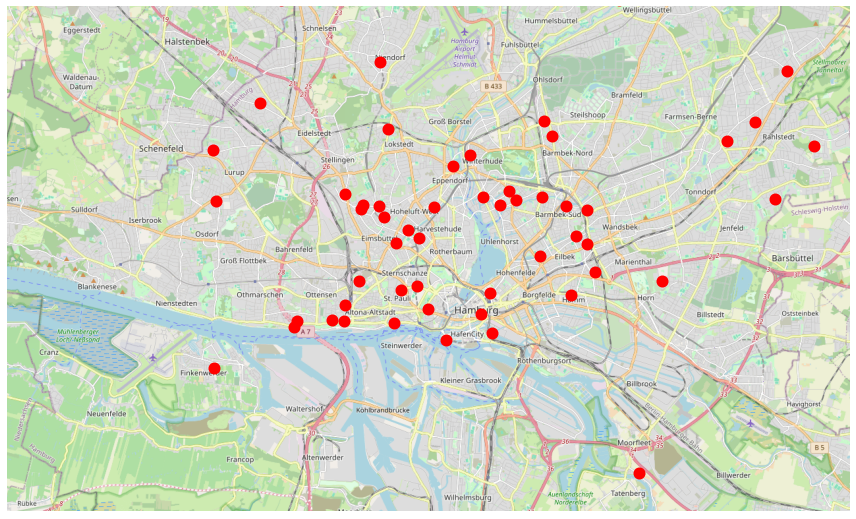

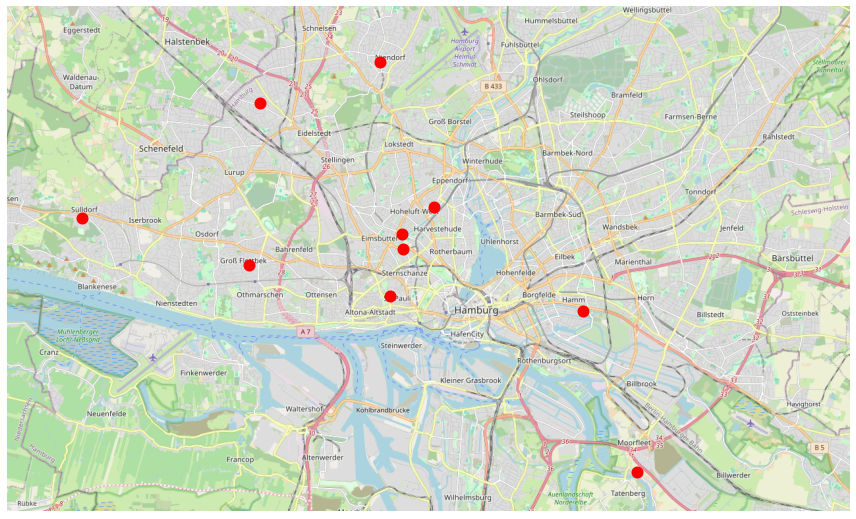

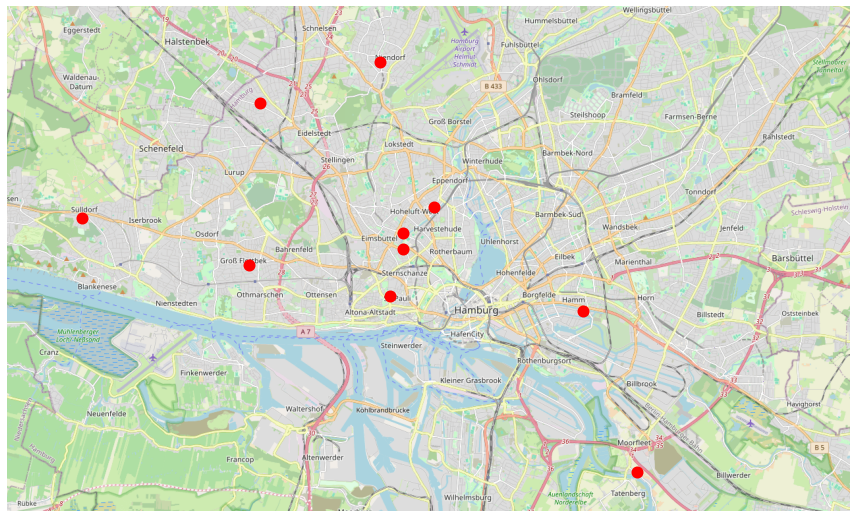

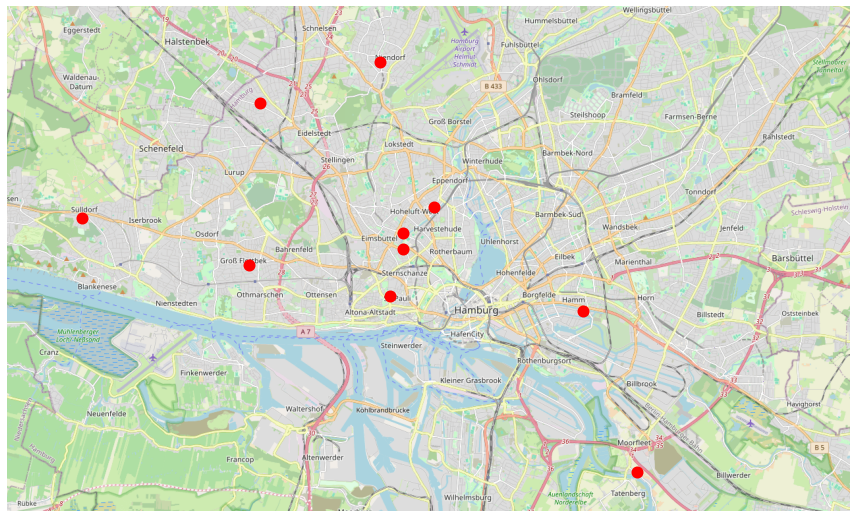

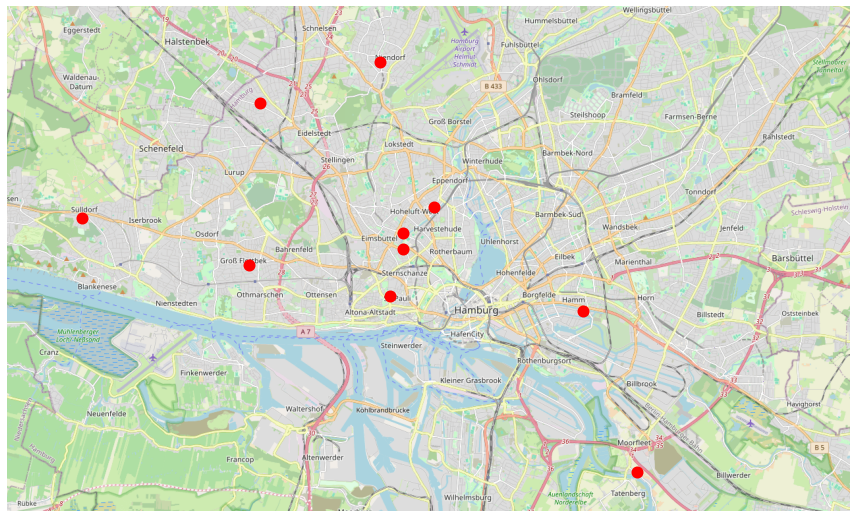

...

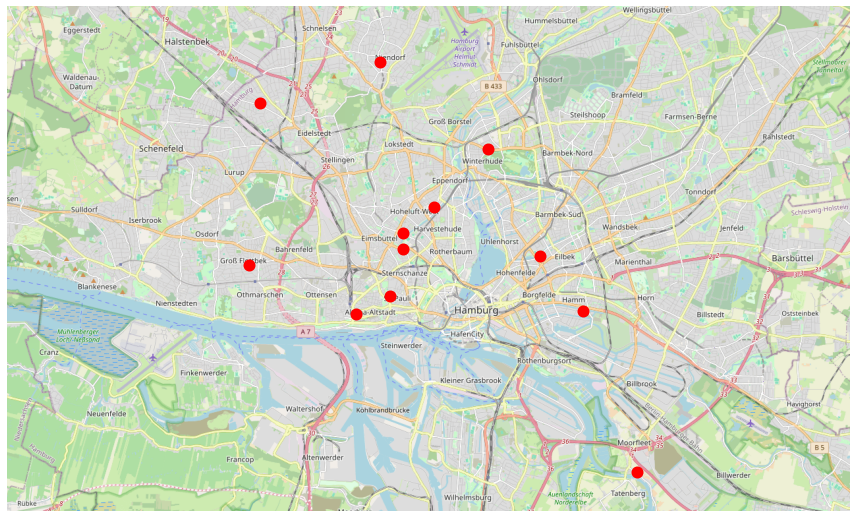

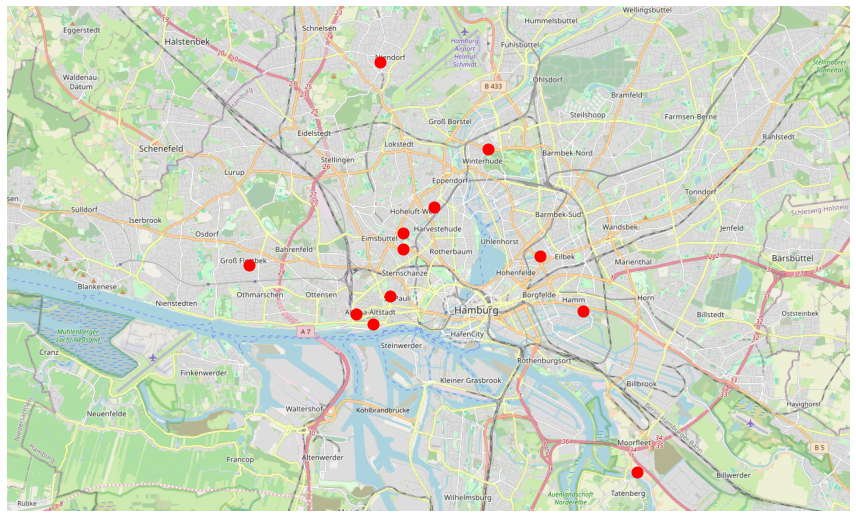

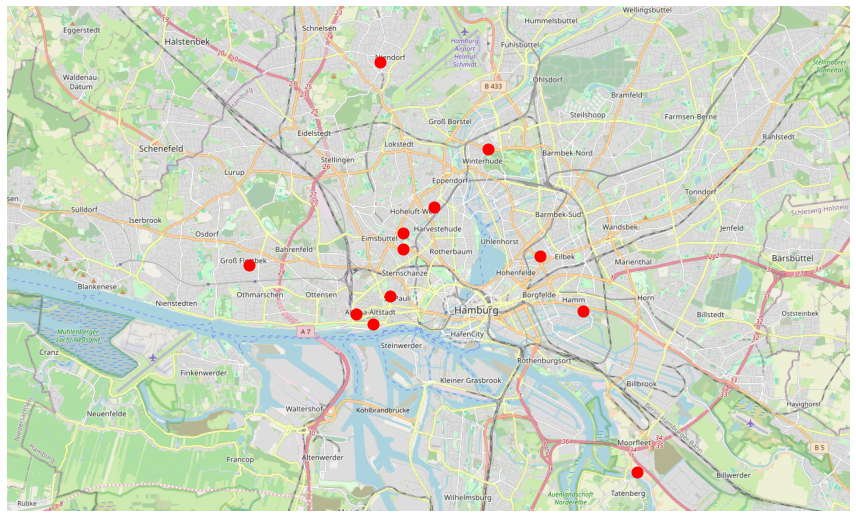

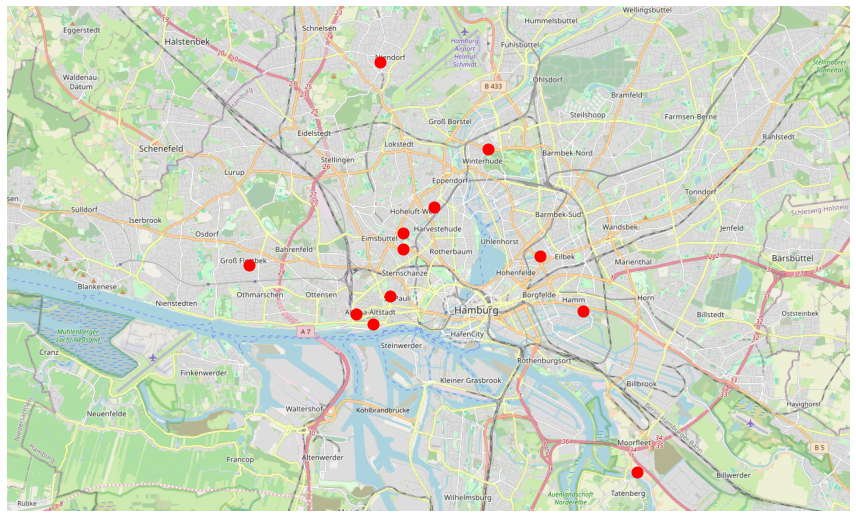

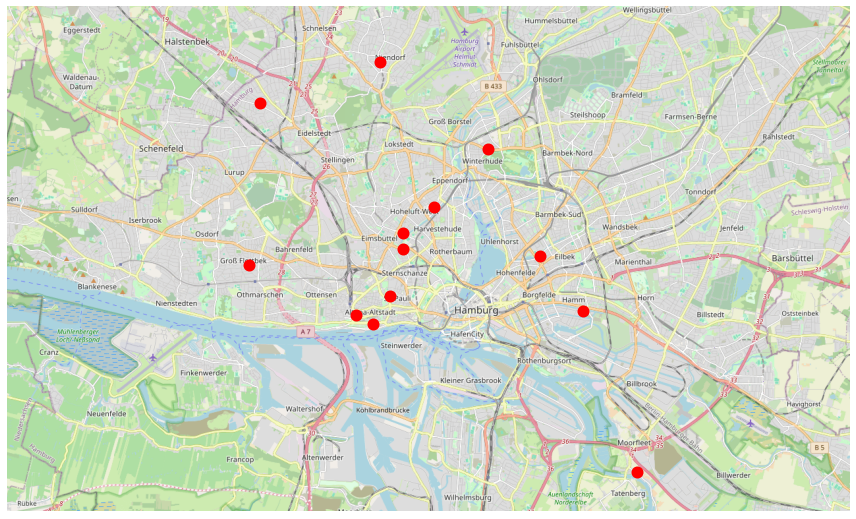

In [ ]:
try:
    mapHH = smopy.Map((53.5, 9.85, 53.62, 10.1), z=12)
    while True:
        positions = log_locations(r"C:\Users\Hauke\critical_length\Sternfahrt2024")
        positions_px_x,positions_px_y = mapHH.to_pixels(positions[:,0],positions[:,1])
        ax = mapHH.show_mpl(figsize=(12, 9))
        ax.plot(positions_px_x,positions_px_y, 'or', ms=10, mew=2);
        display.clear_output(wait=True)
        display.display(plt.gcf())
        sleep(10)
except KeyboardInterrupt:
    pass